# Refine tangram annotations using clustering for lymph_node_s0

In [1]:
slide_id = "lymph_node_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_lymph_node_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 30987, 28915), (3, 15494, 14458)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (702300, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (702300, 7053)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_6786/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 702300 × 7053
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,44.569126,Intermediate EPCAM+ erythroblast
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,20.071997,S100A+ preNeutrophil (cycling)
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,26.416594,Gamma-delta T cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,21.200974,pre-pDC (lymphoid origin)
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,22.329712,preB cell (cycling)
...,...,...,...,...,...
aaaklhfh-1,nucleus_boundaries,morpho,aaaklhfh-1,18.333292,Tissue-resident NK cell
aaaklhfi-1,nucleus_boundaries,morpho,aaaklhfi-1,11.695614,MAIT
aaaklhfj-1,nucleus_boundaries,morpho,aaaklhfj-1,6.322290,Intermediate EPCAM+ erythroblast
aaaklhfk-1,nucleus_boundaries,morpho,aaaklhfk-1,11.764376,Fibroblast


In [6]:
adata_ini.var

""
A2ML1
AAMP
AAR2
AARSD1
ABAT
...
ZSCAN26
ZSWIM6
ZUP1
ZYG11B


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,44.569126,Intermediate EPCAM+ erythroblast,148
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,20.071997,S100A+ preNeutrophil (cycling),189
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,26.416594,Gamma-delta T cell,208
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,21.200974,pre-pDC (lymphoid origin),200
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,22.329712,preB cell (cycling),223
...,...,...,...,...,...,...
aaaklhfh-1,nucleus_boundaries,morpho,aaaklhfh-1,18.333292,Tissue-resident NK cell,80
aaaklhfi-1,nucleus_boundaries,morpho,aaaklhfi-1,11.695614,MAIT,116
aaaklhfj-1,nucleus_boundaries,morpho,aaaklhfj-1,6.322290,Intermediate EPCAM+ erythroblast,36
aaaklhfk-1,nucleus_boundaries,morpho,aaaklhfk-1,11.764376,Fibroblast,20


<Axes: >

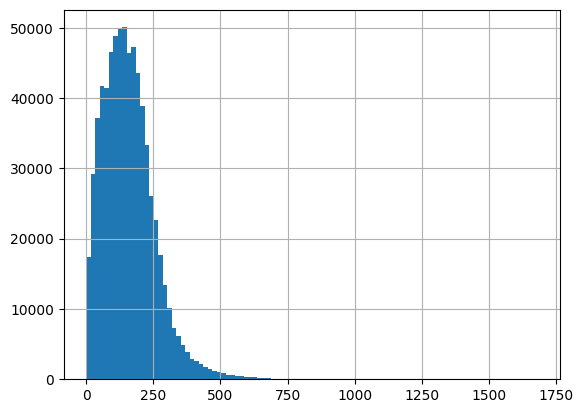

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

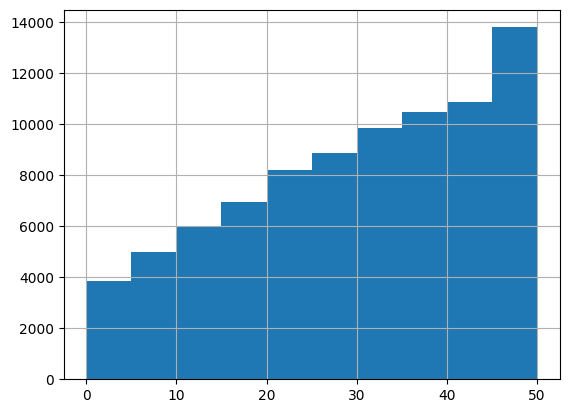

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 21755
Percentage of cells with less than 20 transcripts: 3.1%
-----
Number of cells with less than 15 transcripts: 14801
Percentage of cells with less than 15 transcripts: 2.11%
-----
Number of cells with less than 10 transcripts: 8814
Percentage of cells with less than 10 transcripts: 1.26%
-----
Number total of cells: 702300


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

692384


In [12]:
# Save and do clustering on ruche using gpu
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_att/adata_for_gpu_clustering_{slide_id}.h5ad")

In [12]:
# # Save the raw data
# adata.layers['count'] = adata.X.copy()

In [13]:
# # Normalize
# sc.pp.normalize_total(adata, target_sum=1e4)
# sc.pp.log1p(adata)
# adata.layers['log_norm'] = adata.X.copy()

In [14]:
# # Scale each gene to unit variance. Clip values exceeding standard deviation 10.
# sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [ ]:
# # Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
# sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

In [ ]:
# # Contribution of single PCs to the total variance in the data
# # This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
# sc.pl.pca_variance_ratio(adata, log=True)

In [ ]:
# adata

In [20]:
# # Restore X to be log norm counts
# # /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
# dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [ ]:
# # Neighborhood graph of cells using the PCA representation of the data matrix
# sc.pp.neighbors(adata, n_neighbors=20, n_pcs=16, use_rep="X_pca", key_added='pca_n20_pcs16')
# # Embedding the neighborhood graph using UMAP
# sc.tl.umap(adata, neighbors_key='pca_n20_pcs16', min_dist=0.6)
# # Leiden clustering directly clusters the neighborhood graph of cells
# sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.2', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.4', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.6', neighbors_key='pca_n20_pcs16')

In [3]:
# reload adata after clustring on ruche
adata = sc.read_h5ad(f"/Users/felicie-giraud-sauveur/Documents/HE2CellType/code/CT_DS/data/adata_after_gpu_clustering_{slide_id}.h5ad")

In [4]:
adata

AnnData object with n_obs × n_vars = 692384 × 7053
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'
    var: 'mean', 'std'
    uns: 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

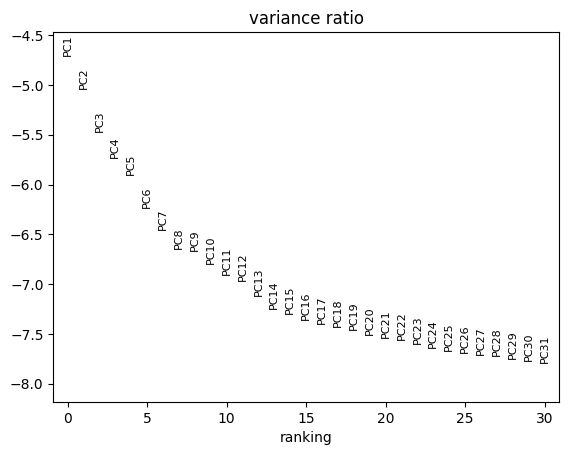

In [5]:
sc.pl.pca_variance_ratio(adata, log=True)

In [6]:
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
print(f"Sum count: {adata.layers['count'].sum()}")
print(f"Sum log_norm: {adata.layers['log_norm'].sum()}")
print(f"Sum X: {adata.X.sum()}")

Sum count: 111759696.0
Sum log_norm: 394620640.0
Sum X: 394620640.0


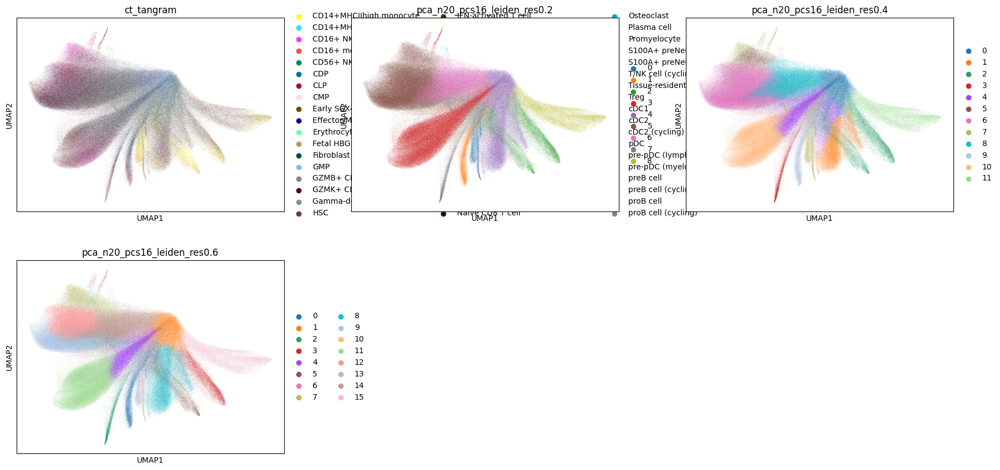

In [7]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n20_pcs16',
           color=['ct_tangram', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'],
           ncols=3)

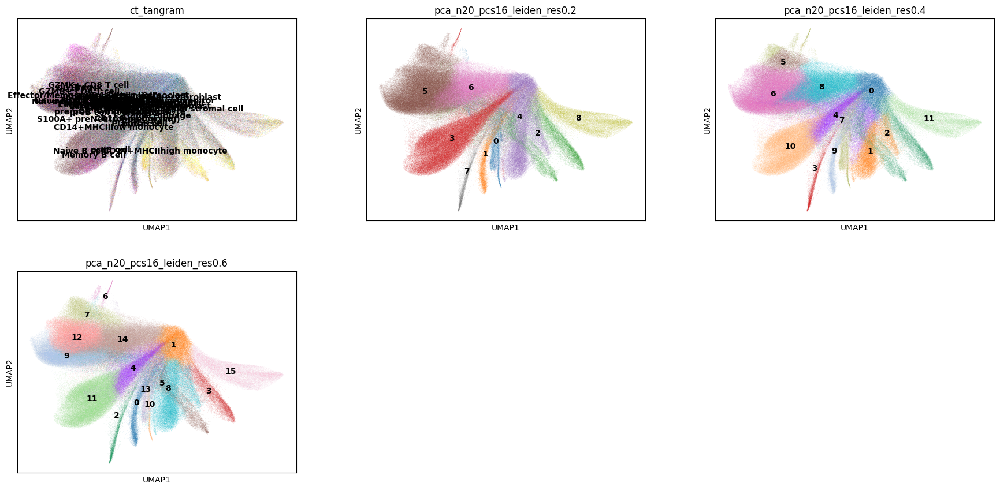

In [8]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n20_pcs16',
           color=['ct_tangram', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

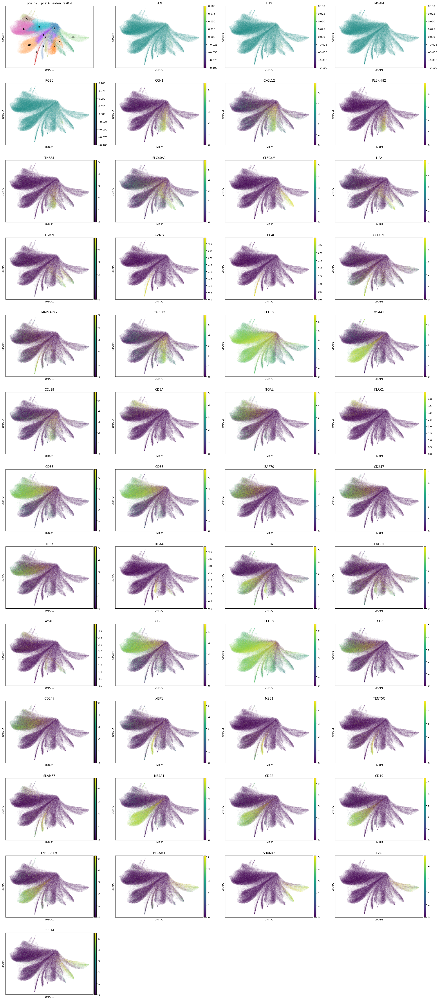

In [9]:
clustering_label = 'pca_n20_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [10]:
# Number of clusters
adata.obs['pca_n20_pcs16_leiden_res0.6'].unique()

['5', '12', '2', '11', '9', ..., '3', '0', '10', '13', '6']
Length: 16
Categories (16, object): ['0', '1', '2', '3', ..., '12', '13', '14', '15']

In [11]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['13']), 'refine_res'] = '13'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['14']), 'refine_res'] = '14'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['15']), 'refine_res'] = '15'

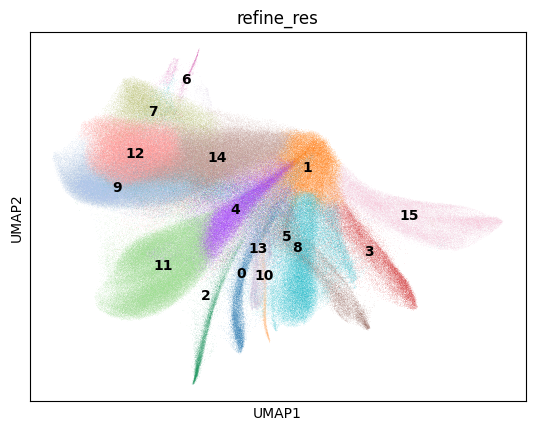

In [12]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n20_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [13]:
clustering_label = 'refine_res'

In [14]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4029/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


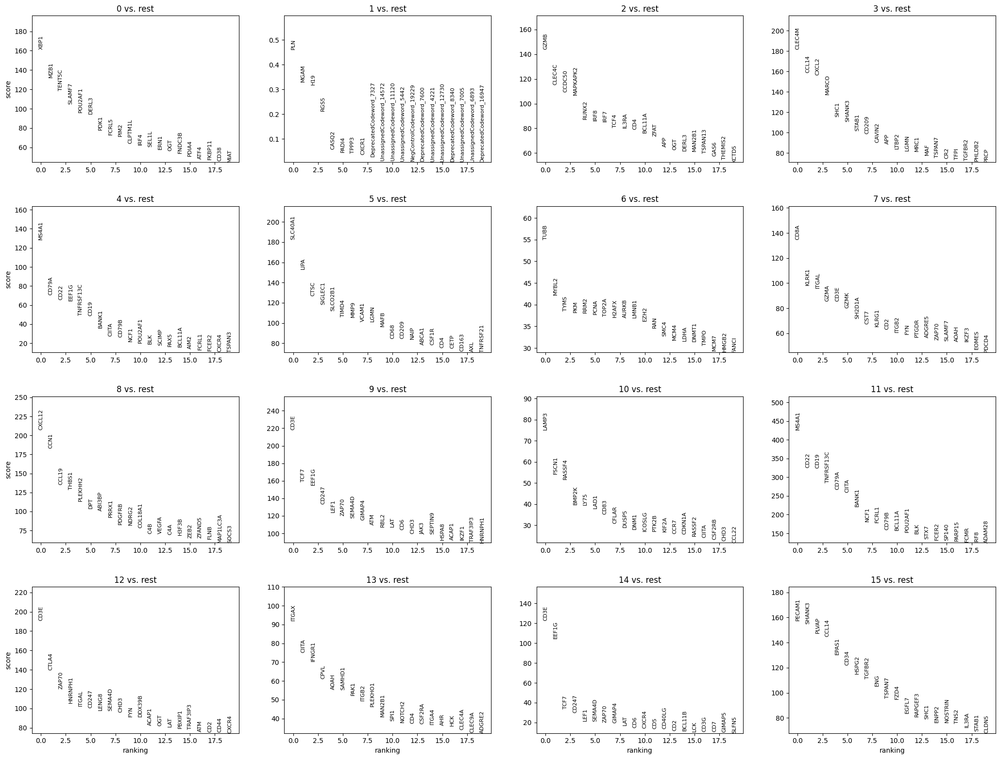

In [15]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [16]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [71]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [72]:
cluster_id = '0'

In [73]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,Plasma cell,18
1,0,preB cell,8
2,0,Intermediate EPCAM+ erythroblast,5
3,0,S100A+ preNeutrophil (cycling),4
4,0,preB cell (cycling),3
5,0,pre-pDC (lymphoid origin),3
6,0,MAIT,3


In [74]:
top_ranked_genes[cluster_id]

0       XBP1
1       MZB1
2     TENT5C
3     SLAMF7
4    POU2AF1
5      DERL3
6       PDK1
Name: 0, dtype: object

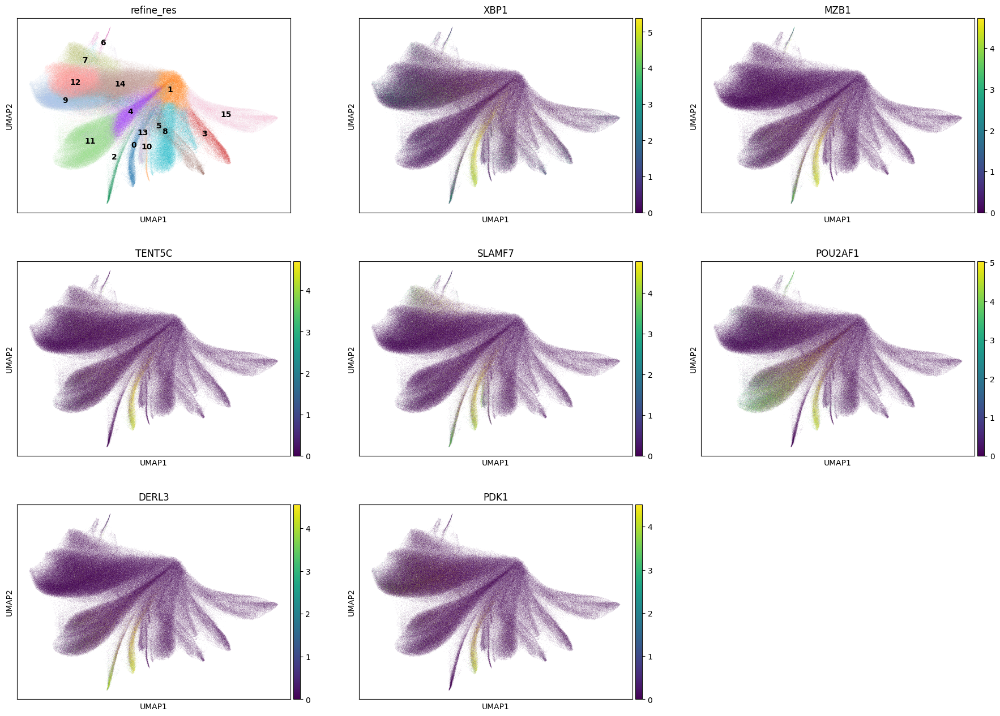

In [75]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [76]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 19781
Percentage of cells in cluster 0: 2.9


In [77]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.2. Cluster 1

In [78]:
cluster_id = '1'

In [79]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Osteoclast,14
8,1,Fibroblast,14
9,1,Megakaryocyte progenitor,10
10,1,Intermediate EPCAM+ erythroblast,9
11,1,Macrophage,5
12,1,cDC1,3
13,1,Mast cell,3


In [80]:
top_ranked_genes[cluster_id]

0      PLN
1     MGAM
2      H19
3     RGS5
4    CASQ2
5    PADI4
6    TPPP3
Name: 1, dtype: object

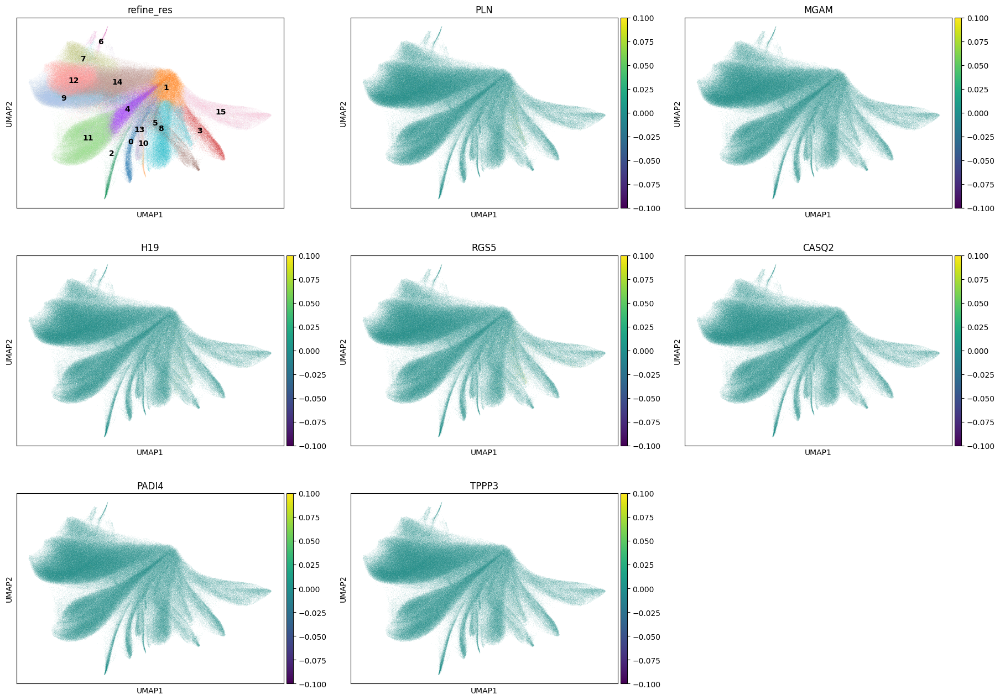

In [81]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [82]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 44797
Percentage of cells in cluster 1: 6.5


In [83]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.3. Cluster 2

In [84]:
cluster_id = '2'

In [85]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,preB cell,17
15,2,pDC,16
16,2,pre-pDC (lymphoid origin),14
17,2,S100A+ preNeutrophil (cycling),6
18,2,CD14+MHCIIlow monocyte,4
19,2,CD16+ NK,4
20,2,CD14+MHCIIhigh monocyte,4


In [86]:
top_ranked_genes[cluster_id]

0        GZMB
1      CLEC4C
2      CCDC50
3    MAPKAPK2
4       RUNX2
5        IRF8
6        IRF7
Name: 2, dtype: object

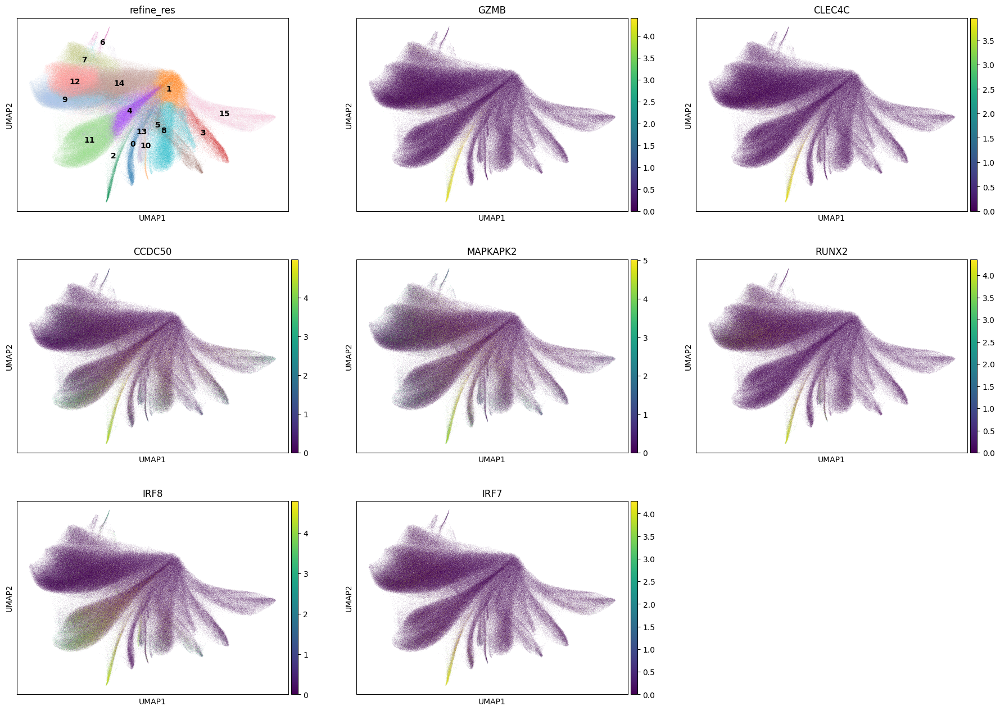

In [87]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [88]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 15116
Percentage of cells in cluster 2: 2.2


In [89]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'pDC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'pDC'

### 5.4. Cluster 3

In [90]:
cluster_id = '3'

In [91]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,CD14+MHCIIhigh monocyte,14
22,3,Early SOX4+ erythroblast,6
23,3,preB cell,5
24,3,Macrophage,5
25,3,Megakaryocyte progenitor,4
26,3,S100A+ preNeutrophil (cycling),4
27,3,Intermediate EPCAM+ erythroblast,4


In [92]:
top_ranked_genes[cluster_id]

0    CLEC4M
1     CCL14
2     CXCL2
3     MARCO
4      SHC1
5    SHANK3
6     STAB1
Name: 3, dtype: object

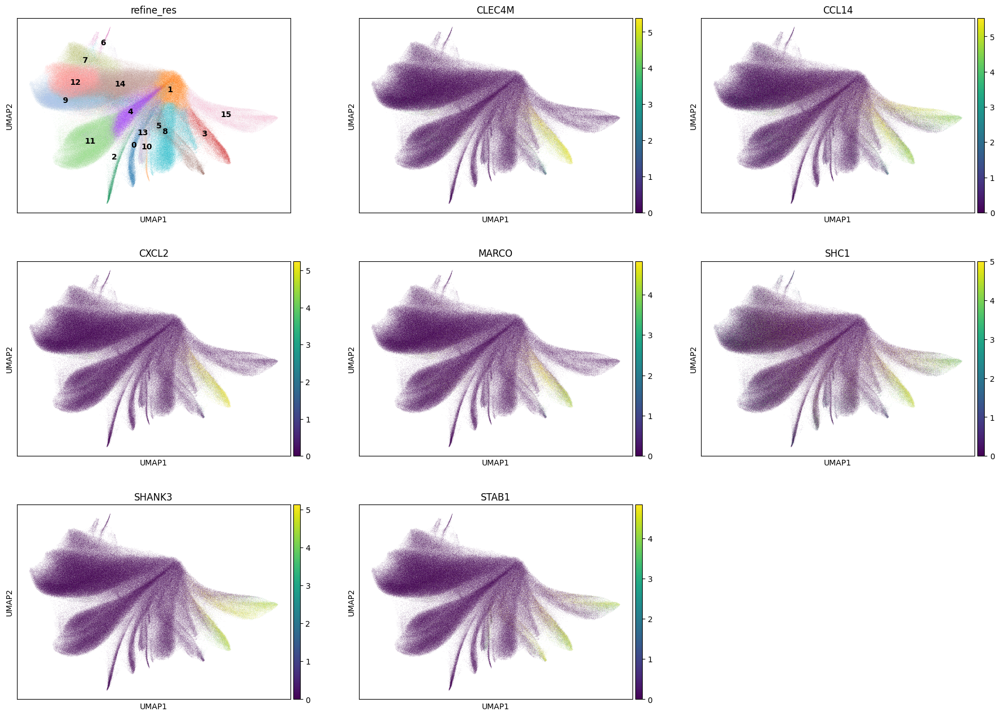

In [93]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [94]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 22613
Percentage of cells in cluster 3: 3.3


In [95]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.5. Cluster 4

In [96]:
cluster_id = '4'

In [97]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Intermediate EPCAM+ erythroblast,9
29,4,Megakaryocyte progenitor,5
30,4,preB cell (cycling),4
31,4,cDC2 (cycling),4
32,4,Early SOX4+ erythroblast,3
33,4,cDC1,3
34,4,Osteoclast,3


In [98]:
top_ranked_genes[cluster_id]

0        MS4A1
1        CD79A
2         CD22
3        EEF1G
4    TNFRSF13C
5         CD19
6        BANK1
Name: 4, dtype: object

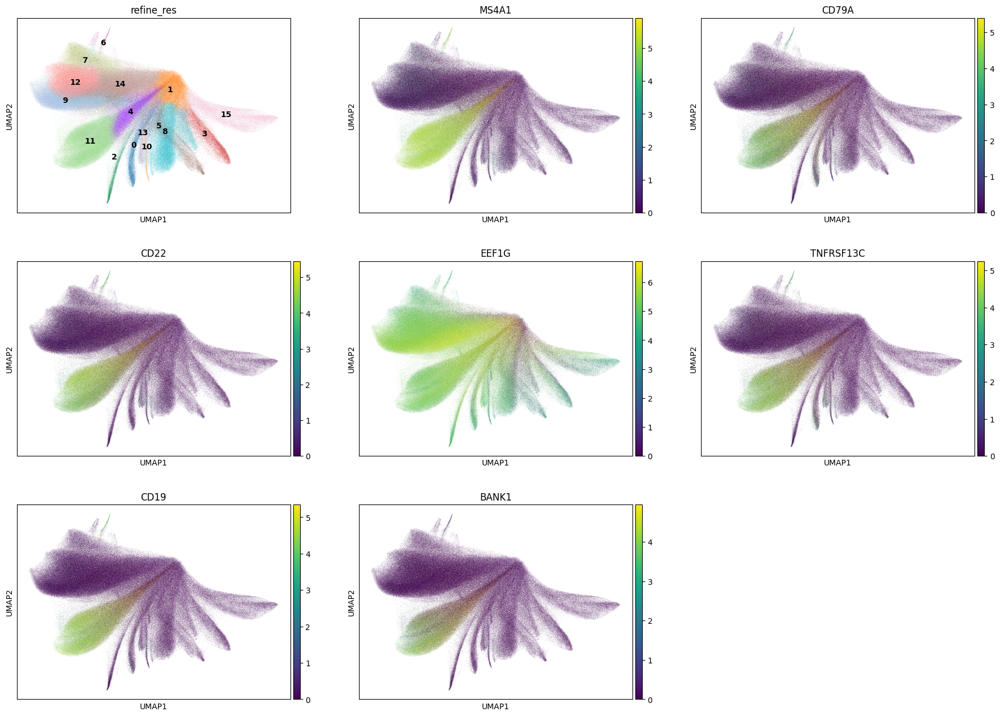

In [99]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [100]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 49640
Percentage of cells in cluster 4: 7.2


In [101]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.6. Cluster 5

In [102]:
cluster_id = '5'

In [103]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,CD14+MHCIIhigh monocyte,19
36,5,Macrophage,13
37,5,S100A+ preNeutrophil (cycling),9
38,5,preB cell,6
39,5,cDC2,5
40,5,CD16+ monocyte,4
41,5,Osteoclast,3


In [104]:
top_ranked_genes[cluster_id]

0    SLC40A1
1       LIPA
2       CTSC
3    SIGLEC1
4    SLCO2B1
5      TIMD4
6       MMP9
Name: 5, dtype: object

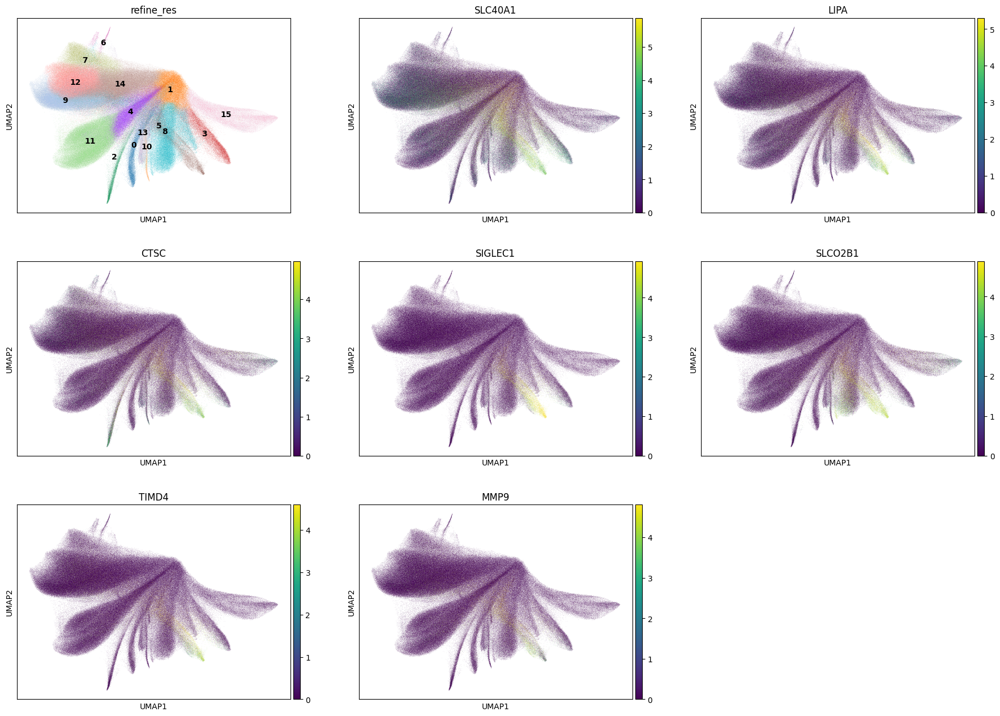

In [105]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [106]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 25901
Percentage of cells in cluster 5: 3.7


In [107]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.7. Cluster 6

In [108]:
cluster_id = '6'

In [109]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,Naive B cell,18
43,6,pre-pDC (lymphoid origin),14
44,6,S100A+ preNeutrophil (cycling),11
45,6,CD16+ NK,10
46,6,preB cell (cycling),9
47,6,Early SOX4+ erythroblast,8
48,6,preB cell,5


In [110]:
top_ranked_genes[cluster_id]

0     TUBB
1    MYBL2
2     TYMS
3      PKM
4     RRM2
5     PCNA
6    TOP2A
Name: 6, dtype: object

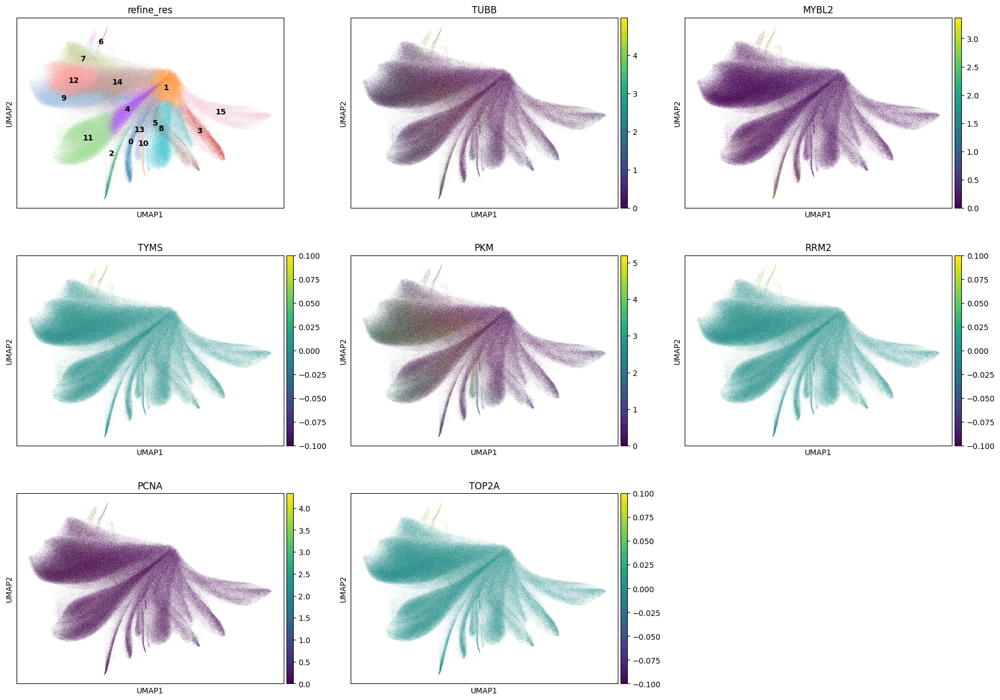

In [111]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [112]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 2703
Percentage of cells in cluster 6: 0.4


In [114]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Proliferating_B_T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_B_T'

### 5.8. Cluster 7

In [115]:
cluster_id = '7'

In [116]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,CD16+ NK,23
50,7,GZMB+ CD8 T cell,12
51,7,GZMK+ CD8 T cell,10
52,7,Tissue-resident NK cell,5
53,7,Naive CD8 T cell,5
54,7,MAIT,4
55,7,S100A+ preNeutrophil (cycling),3


In [117]:
top_ranked_genes[cluster_id]

0      CD8A
1     KLRK1
2     ITGAL
3      GZMA
4      CD3E
5      GZMK
6    SH2D1A
Name: 7, dtype: object

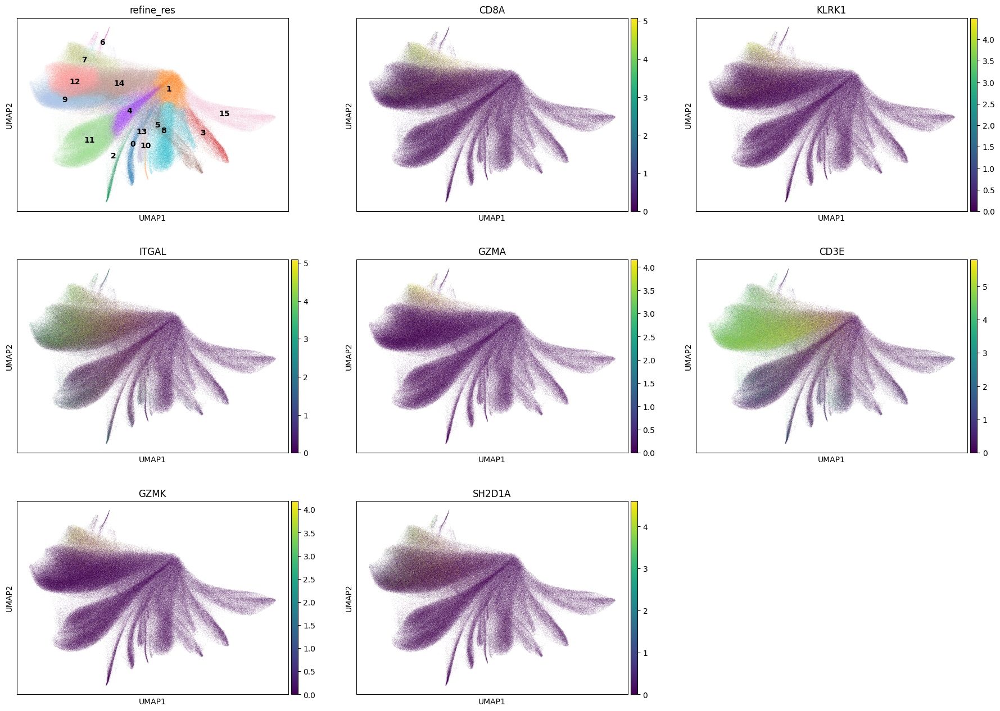

In [118]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [119]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 25074
Percentage of cells in cluster 7: 3.6


In [120]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T/NK'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T/NK'

### 5.9. Cluster 8

In [121]:
cluster_id = '8'

In [122]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Fibroblast,6
57,8,S100A+ preNeutrophil (cycling),5
58,8,Intermediate EPCAM+ erythroblast,4
59,8,preB cell,4
60,8,Early SOX4+ erythroblast,4
61,8,Megakaryocyte progenitor,4
62,8,CD14+MHCIIhigh monocyte,4


In [123]:
top_ranked_genes[cluster_id]

0     CXCL12
1       CCN1
2      CCL19
3      THBS1
4    PLEKHH2
5        DPT
6     ABI3BP
Name: 8, dtype: object

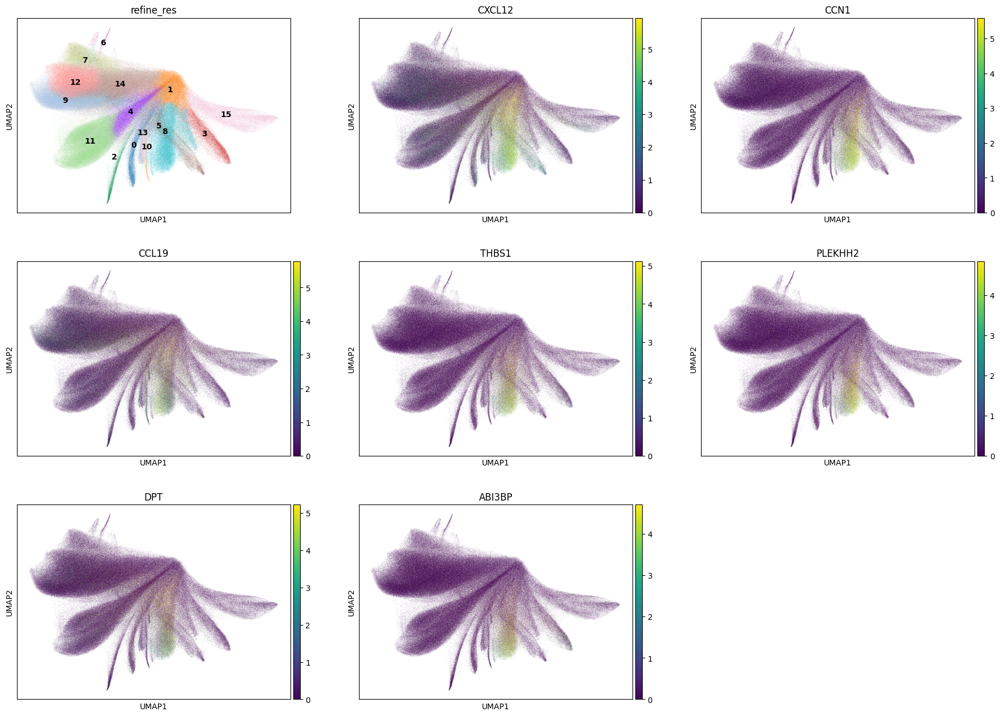

In [124]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [125]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 72709
Percentage of cells in cluster 8: 10.5


In [126]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.10. Cluster 9

In [127]:
cluster_id = '9'

In [128]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,Naive CD8 T cell,19
64,9,Effector/Memory CD4 T cell,9
65,9,Naive CD4 T cell,8
66,9,S100A+ preNeutrophil (cycling),6
67,9,CD16+ NK,5
68,9,GZMB+ CD8 T cell,4
69,9,Treg,4


In [129]:
top_ranked_genes[cluster_id]

0      CD3E
1      TCF7
2     EEF1G
3     CD247
4      LEF1
5     ZAP70
6    SEMA4D
Name: 9, dtype: object

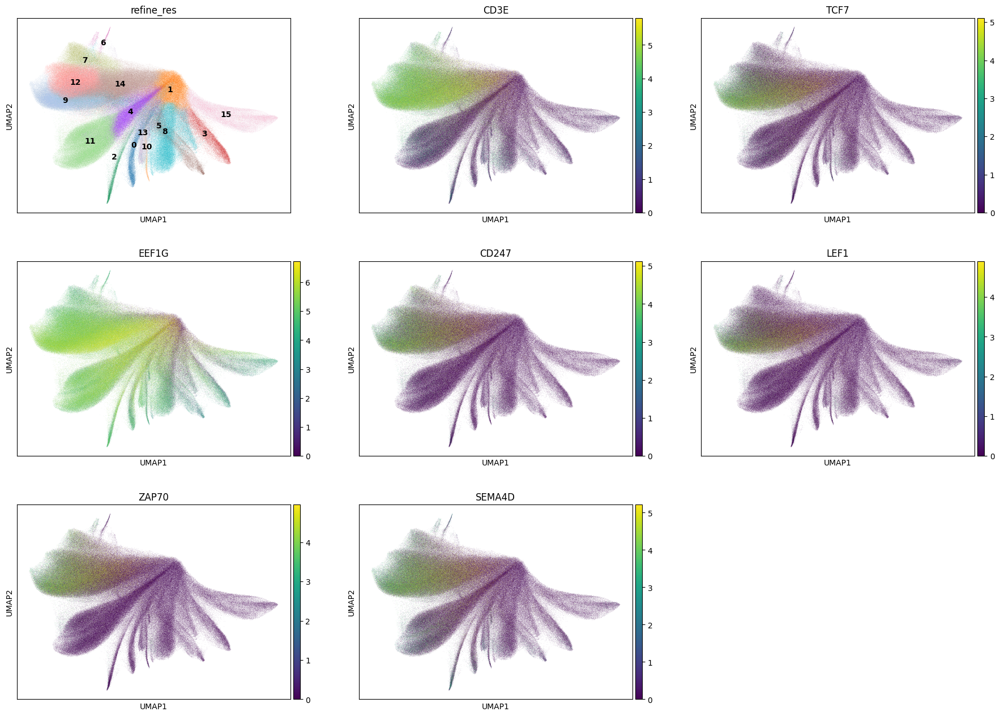

In [130]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [131]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 73334
Percentage of cells in cluster 9: 10.6


In [132]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.11. Cluster 10

In [133]:
cluster_id = '10'

In [134]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
70,10,CD14+MHCIIhigh monocyte,11
71,10,S100A+ preNeutrophil (cycling),8
72,10,Osteoclast,7
73,10,preB cell,7
74,10,Naive B cell,5
75,10,cDC1,5
76,10,MAIT,4


In [135]:
top_ranked_genes[cluster_id]

0     LAMP3
1     FSCN1
2    RASSF4
3     BMP2K
4      LY75
5      LAD1
6      CD83
Name: 10, dtype: object

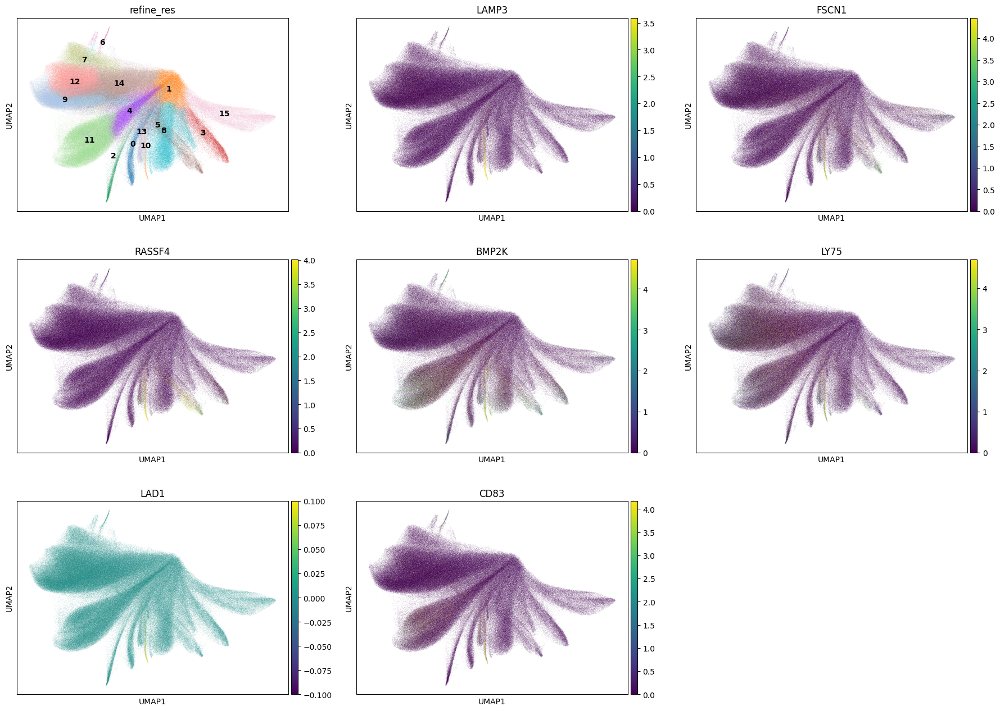

In [136]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [137]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 3937
Percentage of cells in cluster 10: 0.6


In [138]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'DC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'DC'

### 5.12. Cluster 11

In [139]:
cluster_id = '11'

In [140]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
77,11,Naive B cell,29
78,11,Memory B cell,11
79,11,preB cell,8
80,11,S100A+ preNeutrophil (cycling),4
81,11,preB cell (cycling),3
82,11,Intermediate EPCAM+ erythroblast,2
83,11,MAIT,2


In [141]:
top_ranked_genes[cluster_id]

0        MS4A1
1         CD22
2         CD19
3    TNFRSF13C
4        CD79A
5        CIITA
6        BANK1
Name: 11, dtype: object

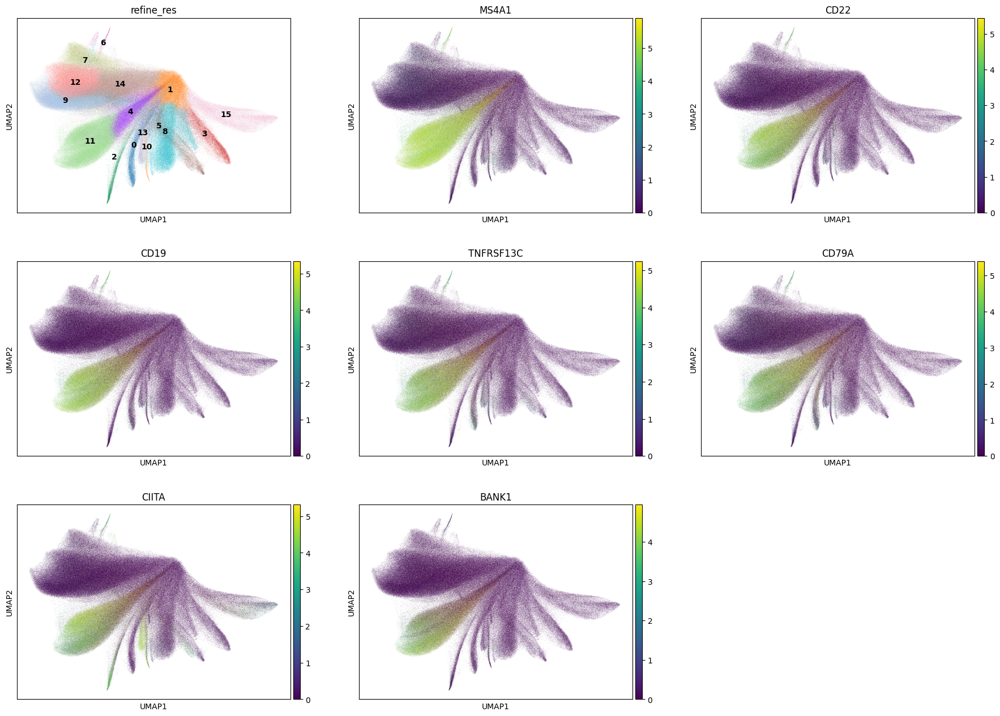

In [142]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [143]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 107112
Percentage of cells in cluster 11: 15.5


In [144]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.13. Cluster 12

In [145]:
cluster_id = '12'

In [146]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
84,12,Treg,10
85,12,Effector/Memory CD4 T cell,8
86,12,Naive CD8 T cell,7
87,12,S100A+ preNeutrophil (cycling),5
88,12,GZMB+ CD8 T cell,5
89,12,Early SOX4+ erythroblast,5
90,12,CD16+ NK,5


In [147]:
top_ranked_genes[cluster_id]

0       CD3E
1      CTLA4
2      ZAP70
3    HNRNPH1
4      ITGAL
5      CD247
6      LENG8
Name: 12, dtype: object

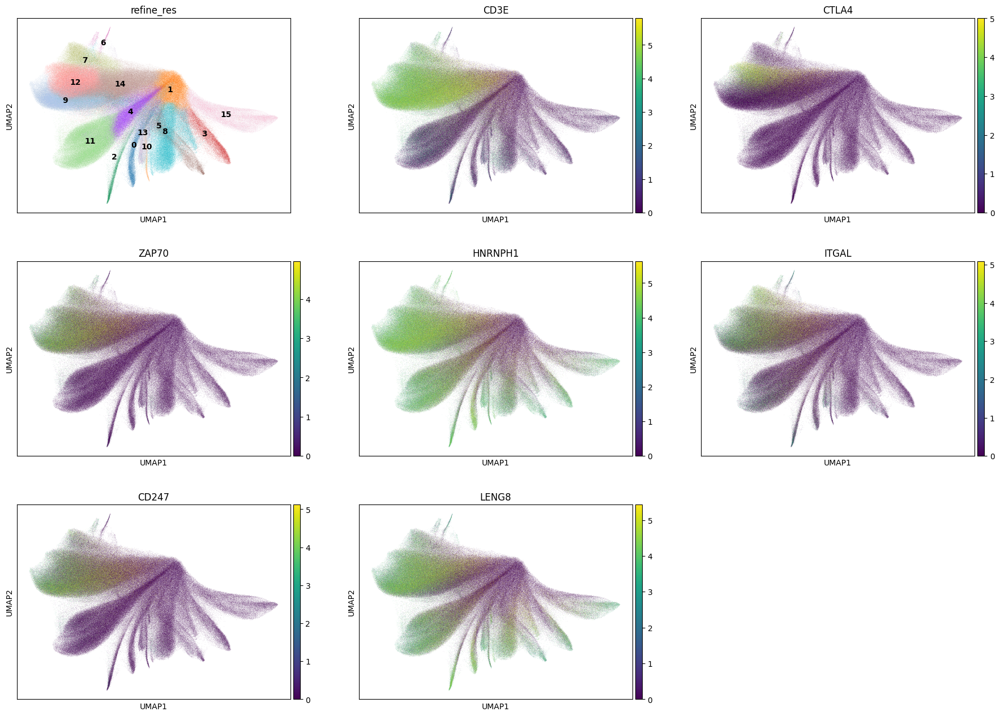

In [148]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [149]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 87587
Percentage of cells in cluster 12: 12.7


In [150]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Treg'

### 5.14. Cluster 13

In [151]:
cluster_id = '13'

In [152]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
91,13,CD14+MHCIIhigh monocyte,26
92,13,S100A+ preNeutrophil (cycling),16
93,13,cDC2,9
94,13,CD14+MHCIIlow monocyte,5
95,13,cDC1,5
96,13,preB cell,4
97,13,Early SOX4+ erythroblast,4


In [153]:
top_ranked_genes[cluster_id]

0     ITGAX
1     CIITA
2    IFNGR1
3      CPVL
4      AOAH
5    SAMHD1
6      PAK1
Name: 13, dtype: object

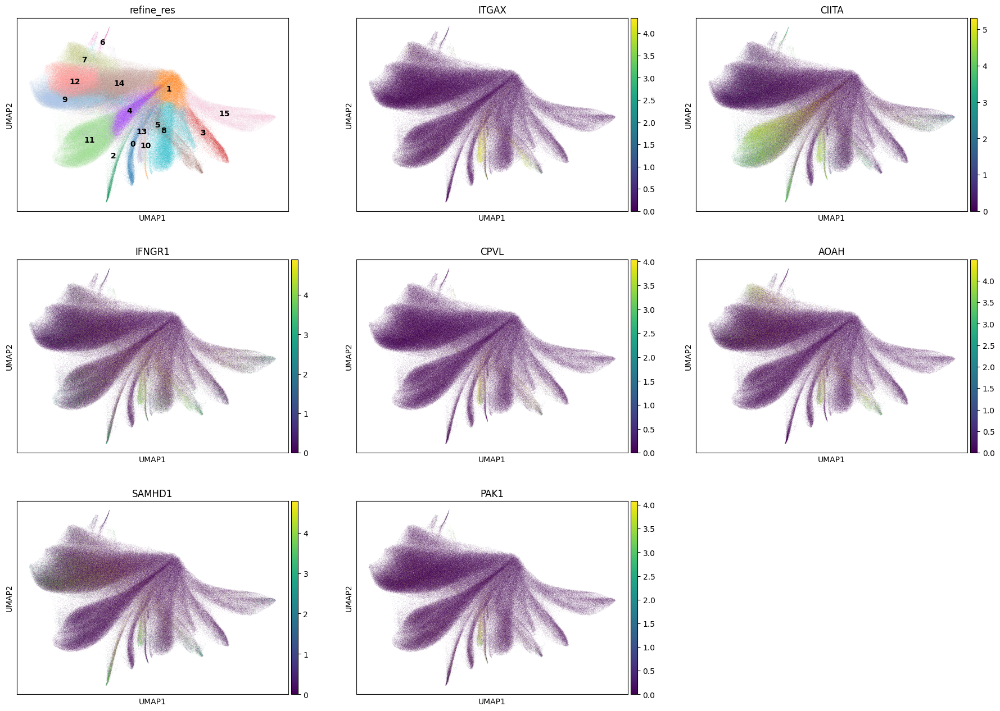

In [154]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [155]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 12737
Percentage of cells in cluster 13: 1.8


In [156]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage/DC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage/DC'

### 5.15. Cluster 14

In [157]:
cluster_id = '14'

In [158]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
98,14,Intermediate EPCAM+ erythroblast,10
99,14,Megakaryocyte progenitor,5
100,14,Early SOX4+ erythroblast,4
101,14,MAIT,3
102,14,ILC,3
103,14,cDC1,3
104,14,cDC2 (cycling),3


In [159]:
top_ranked_genes[cluster_id]

0      CD3E
1     EEF1G
2      TCF7
3     CD247
4      LEF1
5    SEMA4D
6     ZAP70
Name: 14, dtype: object

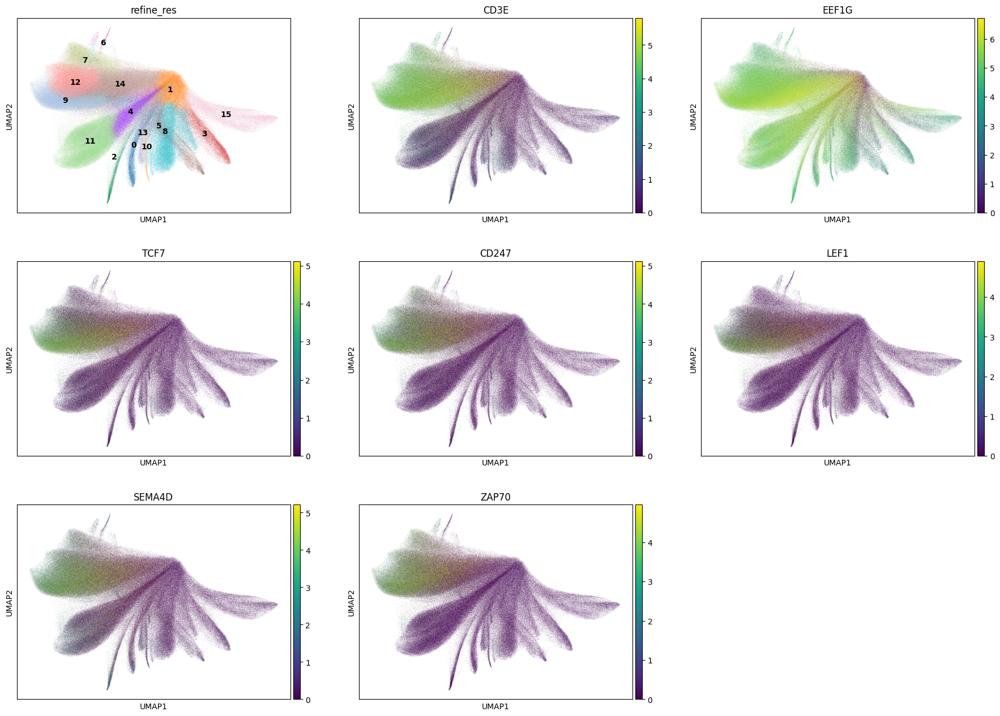

In [160]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [161]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 14: 96178
Percentage of cells in cluster 14: 13.9


In [162]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.16. Cluster 15

In [163]:
cluster_id = '15'

In [164]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
105,15,S100A+ preNeutrophil (cycling),7
106,15,CD14+MHCIIhigh monocyte,7
107,15,proB cell,6
108,15,CMP,6
109,15,Megakaryocyte progenitor,5
110,15,Early SOX4+ erythroblast,5
111,15,Mesenchymal stromal cell,5


In [165]:
top_ranked_genes[cluster_id]

0    PECAM1
1    SHANK3
2     PLVAP
3     CCL14
4     EPAS1
5      CD34
6     HSPG2
Name: 15, dtype: object

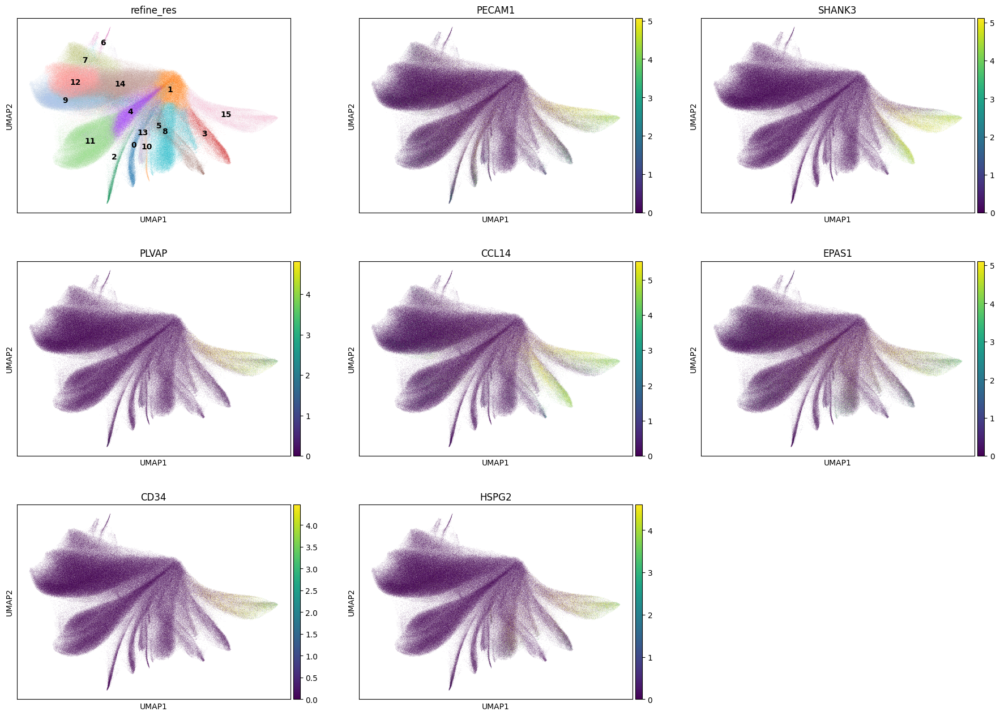

In [166]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [167]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 15: 33165
Percentage of cells in cluster 15: 4.8


In [168]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

## 6. Cancer cells

In [170]:
adata.obs['label1'].unique()

array(['Monocyte/Macrophage', 'T', 'pDC', 'B', 'Unknown', 'Fibroblast',
       'T/NK', 'Endothelial', 'Plasma', 'DC', 'Macrophage/DC',
       'Proliferating_B_T'], dtype=object)

In [171]:
adata.obs['label2'].unique()

array(['Monocyte/Macrophage', 'Treg', 'pDC', 'B', 'T', 'Unknown',
       'Fibroblast', 'T/NK', 'Endothelial', 'Plasma', 'DC',
       'Macrophage/DC', 'Proliferating_B_T'], dtype=object)

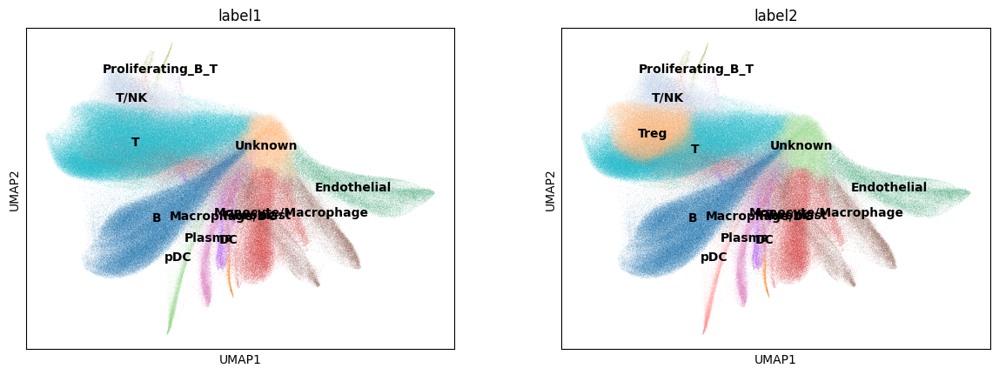

In [172]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [173]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'

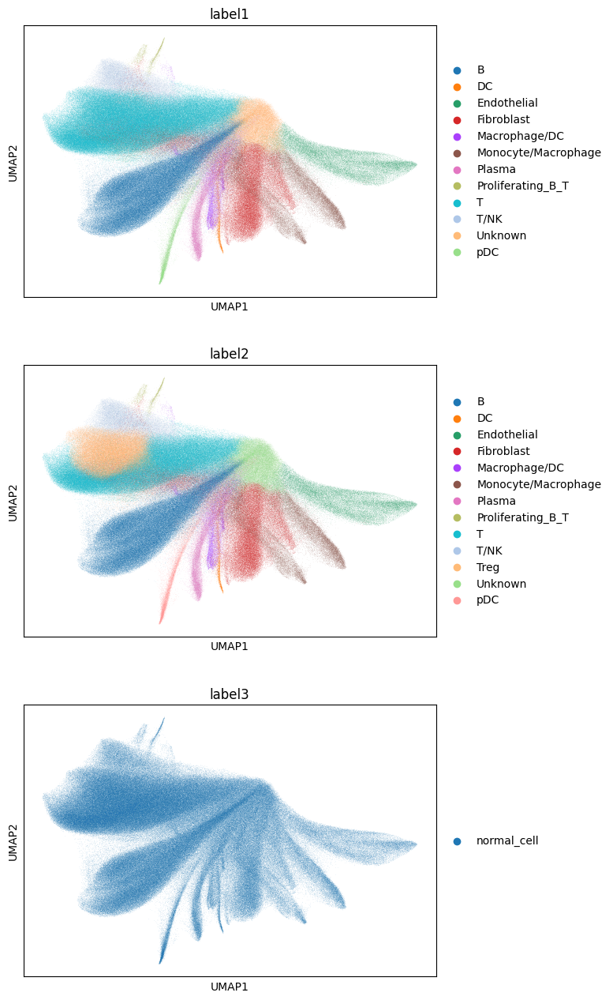

In [174]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [175]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,44.569126,Intermediate EPCAM+ erythroblast,148,2,8,5,5,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,20.071997,S100A+ preNeutrophil (cycling),189,5,6,12,12,T,Treg,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,26.416594,Gamma-delta T cell,208,5,6,12,12,T,Treg,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,21.200974,pre-pDC (lymphoid origin),200,5,3,2,2,pDC,pDC,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,22.329712,preB cell (cycling),223,3,10,11,11,B,B,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaklhfh-1,nucleus_boundaries,morpho,aaaklhfh-1,18.333292,Tissue-resident NK cell,80,8,11,15,15,Endothelial,Endothelial,normal_cell
aaaklhfi-1,nucleus_boundaries,morpho,aaaklhfi-1,11.695614,MAIT,116,4,1,8,8,Fibroblast,Fibroblast,normal_cell
aaaklhfj-1,nucleus_boundaries,morpho,aaaklhfj-1,6.322290,Intermediate EPCAM+ erythroblast,36,6,8,14,14,T,T,normal_cell
aaaklhfk-1,nucleus_boundaries,morpho,aaaklhfk-1,11.764376,Fibroblast,20,4,0,1,1,Unknown,Unknown,normal_cell


In [176]:
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")